# Final Project 
# Anaysis of Traffic Accidents in San Francisco

It is a group project for the course [Social data analysis and visualization (02806)](https://kurser.dtu.dk/course/2022-2023/02806) offered by the [Technical University of Denmark](dtu.dk) in spring 2023. Our group members are Mustafa Khudhair Abbas Al-Azawi(s230364), Ibrahim Al-Bacha(s118016), Xueying Chen(s216410).

This project is built on the [US Accidents (2016 - 2021)](https://www.kaggle.com/datasets/sobhanmoosavi/us-accidents) dataset and combined with 
[Police Department Incident Reports: 2018 to Present](https://data.sfgov.org/Public-Safety/Police-Department-Incident-Reports-2018-to-Present/wg3w-h783) as well as [Police Department Incident Reports: Historical 2003 to May 2018](https://data.sfgov.org/Public-Safety/Police-Department-Incident-Reports-Historical-2003/tmnf-yvry).

There are six main sections:
- Motivation.
- Exploratory Analysis
    - Mapping
    - Datetime
- Data Analysis: 
    - what could make an incident worse than the others?
    - could some incidents be crime-related?
- Genre.
- Visualizations.
- Discussion.

----

# I. Motivation:

This project aims to investigate traffic incidents in San Francisco using publicly available data. Driving in San Francisco has been described as challenging due to its steep hills, narrow streets, changing traffic rules, and complex parking rules [Source: [Uber](https://www.uber.com/blog/san-francisco/driving-like-a-pro-in-san-francisco/)].

Furthermore, the famous 2470-km-long U.S. Route 101 also travels through San Francisco, connecting multiple highways and interstates which in turn adds to the complexity of driving in San Francisco. 

Our motivation to choosing this particular projects originates from multiple causes with the root being the class-wide Project Assignment A runthrough and Peergrade review of classmates' projects. We found this particular project idea interesting because of its weight on both geodata and datetime analysis. We have chosen the abovementioned Traffic Incident dataset due to its size, thorough content, and wide range of cities available for closer inspection. The city selectin of San Francisco is, however, arbitrary and we'd like our analyses to be applicable to whichever selected city.

Our desired end goal with this project is to produce an analysis workflow in which any city’s traffic incidents can be investigated, especially in combination with other data sets, such as crime data.

---


Importing packages and loading data:

In [ ]:
# Importing packages and dependencies
import json
import folium
import urllib.request

import numpy as np
import pandas as pd
import seaborn as sns
import numpy.random as rnd

import matplotlib.colors as mcolors
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go

from folium import plugins
from matplotlib import cm

from folium.plugins import HeatMap
from shapely.geometry import shape, Point

# Packages for the Machine Learning part
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix
from sklearn.model_selection import train_test_split, GridSearchCV

# NLP APIs
import nltk
from wordcloud import WordCloud
from nltk.corpus import stopwords

# Bokeh Interactive Visualization
from bokeh.io import output_notebook
from bokeh.plotting import figure, show
import bokeh.palettes as bpalettes
output_notebook()


Loading BokehJS ...

In [7]:
# load the .csv file
df_all = pd.read_csv('US_Accidents_Dec21_updated.csv',
                     engine='python')

# sort out the data from San Francisco
df = df_all[df_all['City'] == 'San Francisco']
df.to_csv('sf.csv', index=False)

In [2]:
# load the .csv file
df = pd.read_csv('sf.csv',
                 engine='python')
df.name = 'Traffic Incidents Report of San Francisco'

---

# II. Exploratory Analysis

To start off our project, we'd like to perform exploratory analysis to gain a better understanding of the data. Exploratory analysis is an essential step in data analytics regardless of what analyses one wants to perform, to not only ensure data quality but also notably to detect potential issues.

The U.S. Accidents (2016-2021) dataset from Kaggle contains information on approximately 2.8 million accidents that occurred in the United States between February 2016 and December 2021, with wide range of attributes such as location (latitude & longitude), severity (level 1-4), weather conditions(temperature, humidity, wind direction etc.), and timestamp of the accident, i.e., in total 47 columns.

Among all the cities, San Francisco is our target. Therefore, we filtered the data and kept only total of 6924 accidents recorded, that were happened in SF. Most of the features that we used were without missing values (NaN), but when we came further to the decision tree part, we chose to fill the NaN values with the mean values, which would hopefully preserve the original distribution of the variable and is a simple method to complete the dataset.

During this section, we found that:
- accidents tends to happen during daytime
- highway and freeway constitutes most frequent accident spots
- December is the month with most incidents


## 1. Mapping

As our project is centered around San Francisco, we'd like to firstly produce and examine a heatmap of the data. Our geodata comprises of start- and end-coordinates of latitude and longitude of the polylines affected by logged traffic incidents. We use the start coordinates to plot the heatmap. 

In the following heatmap, we observe that while traffic incidents occur scattered across most of San Francisco, the highest densities can be found centered around the Oakland Bay Bridge, Dwight D. Eisenhower Highway and Bayshore Freeway (both are parts of Interstate 80 and U.S. Route 101), and the highway roundabout between Route 101 and Interstate 280.

#### a) Heatmap for San Francisco Traffic Incidents

In [3]:
# set up the map
heatmap = folium.Map([37.7749, -122.4194],
                     zoom_start=11,
                     tiles="Stamen Toner")

# list comprehension to make out list of lists
heat_data = [[row['Start_Lat'], row['Start_Lng']] for _, row in df.iterrows()]

# plot it on the map
HeatMap(heat_data, max_opacity=0.8,
        radius=10, blur=10).add_to(heatmap)

heatmap

By dividing the city as per its districts, we can examine the regional incident distribution with a choropleth map.

As expected in the following choropleth map, we recognize the pattern that most incidents take place in the districts containing the abovementioned passage: Route 101, Interstate 80, and Interstate 280. The district containing the top most incidents is Southern (spanning the SoMa major neighborhood), followed by Mission District and Bayview where the densities follow Route 101 along the coastline.

In [4]:
# init the map
json_path = "https://raw.githubusercontent.com/suneman/socialdata2022/main/files/sfpd.geojson"
with urllib.request.urlopen(json_path) as response:
    sf = json.load(response)

map_sf = folium.Map([37.761, -122.465], zoom_start=12,
                    tiles="cartodbpositron")

folium.Choropleth(
    geo_data=sf,
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.8,
    reset=True,
).add_to(map_sf)

In [5]:
# function for sorting the incidents into the police districts accordingly
def get_district(lat, lng):
    point = Point(lng, lat)

    for feature in sf['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(point):
            return feature['properties']['DISTRICT']

    return 'Unknown'

In [6]:
# fill the district into the df
df['District'] = np.nan
for i in range(df.shape[0]):
    df.at[i, 'District'] = get_district(df.at[i, 'Start_Lat'],
                                        df.at[i, 'Start_Lng'])

In [7]:
# filter out the wanted column
df_incident_cnt = df.loc[:, ["District"]]

# count the number of incidents in each district
df_incident_cnt = df_incident_cnt.value_counts("District")
df_incident_cnt = df_incident_cnt.reset_index()
df_incident_cnt.columns = ["District", "IncidentCounts"]

fig = px.choropleth_mapbox(df_incident_cnt, geojson=sf,
                           locations="District",
                           color='IncidentCounts',
                           color_continuous_scale="rdbu_r",
                           range_color=(0, 2300),
                           mapbox_style="carto-positron",
                           zoom=10,
                           center={"lat": 37.7749, "lon": -122.4194},
                           opacity=0.8
                           )

fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()

Similar conclusions can be extracted from following figure where we color-code the incidents as per their district. We add red map markers on the most dense polyline. This figure makes it clearly visible that the most dense polyline spans from the start of the Oakland Bay Bridge to the south-end of Southern district. We note that this figure also suggests higher densities in other districts depending on their distance to Route 101.

In [38]:
st_icd_cnt = df['Street'].value_counts().to_dict()
most_common_st_1 = dict(list(st_icd_cnt.items())[0:1])

In [39]:
df_most_common = df[df['Street'].isin(most_common_st_1.keys())]

for index, row in df_most_common.iterrows():
    lat, lon = row['Start_Lat'], row['Start_Lng']
    label = row['Street']
    marker = folium.Marker(location=[lat, lon], popup=label,
                           icon=folium.Icon(color="red",
                                            icon="flag"))
    marker.add_to(map_sf)

display(map_sf)

Following is summarized word clouds, divided by districts using incident descriptions. This is not used for any further analyses, however, we found it interesting to inspect for any particularly interesting occurences.

In [10]:
# shorten function for lemmation
# can only handle one word at a time
# it will "purify" the tokens
lemmatizer = nltk.wordnet.WordNetLemmatizer()
lemma = lemmatizer.lemmatize

In [11]:
# generate wordclouds
group_list = df.District.unique()
cloud_list = []

for idx, i in enumerate(group_list):
    des = df.Description[df.District.isin([i])].to_string()
    des = lemma(des)
    wordcloud = WordCloud(max_font_size=160, max_words=50,
                          width=1600, height=800,
                          colormap='plasma',
                          stopwords=stopwords.words('english'),
                          background_color="white").generate(des)
    cloud_list.append(wordcloud)

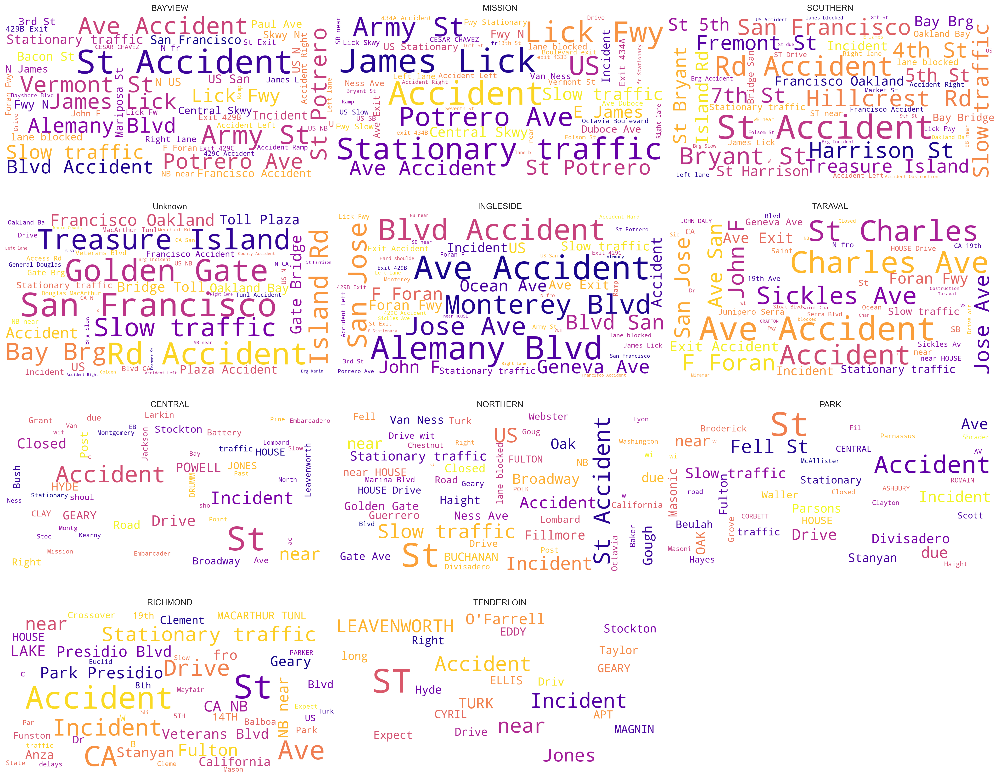

In [13]:
# plotting
fig = plt.figure(figsize=(20, 16), dpi=300)
plt.subplots_adjust(hspace=0.5)
for idx, cloud in enumerate(cloud_list):
    ax = plt.subplot(4, 3, idx+1)
    ax.imshow(cloud, interpolation="bilinear")
    ax.set_axis_off()
    ax.set_title(group_list[idx])

plt.tight_layout(pad=.3)
plt.show()

## 2. Datetime

We convert incident time details to datetime to examine the frequency distributions of weekdays and hours. In the resulting figures, we observe particular details: the majority of the incidents happen during the daytime, with Thursday being the most dominant weekday in our data, although only slightly edging Friday. The daily peak of incidents happens 12:00 AM every day bar Sunday.

Furthermore, we observe that December is the month with most incidents, followed by the months leading up to December. The figure also shows how May and June are plagued with traffic incidents, but sees a steep fall in July.

In [14]:
# convert the Time stamp to more specific columns
df['Start_Time'] = df['Start_Time'].astype('datetime64')
df['Year'] = df['Start_Time'].dt.year
df['Month'] = df['Start_Time'].dt.month
df['Hour'] = df['Start_Time'].dt.hour

# find out which week day that the incident happened
df['Weekday'] = df['Start_Time'].apply(lambda x: x.strftime('%A'))
df['Day_Id'] = df['Start_Time'].dt.dayofweek

In [15]:
# init figure
fig = plt.figure(figsize=(36, 20), dpi=280)
gs  = fig.add_gridspec(2, 2)
fig.subplots_adjust(hspace=.5)

# calculate stats
w_stats = df['Day_Id'].value_counts().sort_index()
m_stats = df['Month'].value_counts().sort_index()
wh_stats = df.loc[:, ['Day_Id', 'Hour']].value_counts().sort_index()
wh_stats = wh_stats.to_frame(name='count').reset_index()

# sort weekday
sorter = ['Monday', 'Tuesday', 'Wednesday', 'Thursday',
          'Friday', 'Saturday', 'Sunday', ]
sorter_dict = dict(zip(range(len(sorter)), sorter))

# plotting
cols = tuple(cm.Reds(w_stats.values / float(max(w_stats.values))))
ax00 = fig.add_subplot(gs[0, 0])
ax00.bar(w_stats.index, w_stats.values, color=cols)
ax00.set_title("Weekly Pattern", size=30)
ax00.set_xticks(range(len(df.Day_Id.unique())))
ax00.set_xticklabels(['Monday', 'Tuesday', 'Wednesday',
                      'Thursday', 'Friday', 'Saturday',
                      'Sunday'], rotation=25, size=20)
ax00.set_yticks(range(0, 1500, 200))
ax00.tick_params(axis='y', labelsize=22)
ax00.set_ylabel('Incident Count', size=22)

ax01 = fig.add_subplot(gs[0, 1])
cols = tuple(cm.Reds(m_stats.values / float(max(m_stats.values))))
ax01.bar(m_stats.index, m_stats.values, color=cols)
ax01.set_title("Monthly Pattern", size=30)
ax01.set_xticks(range(1, 13))
ax01.set_xticklabels(['January', 'February', 'March', 'April',
                      'May', 'June', 'July', 'August', 'September',
                      'October', 'November', 'December'],
                     rotation=25, size=20)
ax01.set_yticks(range(0, 1500, 200))
ax01.tick_params(axis='y', labelsize=20)

ax1 = fig.add_subplot(gs[1, :])
cols = tuple(cm.Reds(wh_stats['count'] / float(max(wh_stats['count']))))
ax1.bar(wh_stats.index, wh_stats['count'], color=cols)
ax1.set_title("Hourly Pattern within a Week", size=30)
x_ticks, x_ticklabels, i = [], [], 0
for x in wh_stats.index:
    if x % 24 == 0:
        x_ticks.append(x)
        x_ticklabels.append(str(sorter_dict.get(i))+' 00:00')
    elif x % 24 == 12:
        x_ticks.append(x)
        x_ticklabels.append(str(sorter_dict.get(i))+' 12:00')
        i += 1
ax1.set_xticks(x_ticks)
ax1.set_xticklabels(x_ticklabels, size=20, rotation=25)
ax1.tick_params(axis='y', labelsize=20)
ax1.set_xlabel('Hour of a Week', size=22)
ax1.set_ylabel('Incident Count', size=22)

fig.suptitle('Number of traffic incidents in different patterns',
             x=.5, y=.95, fontsize=42)
fig.tight_layout(pad=.3, rect=[0, .03, 1, .945])
plt.show()

#### b) Marginal distributions (with where and when)

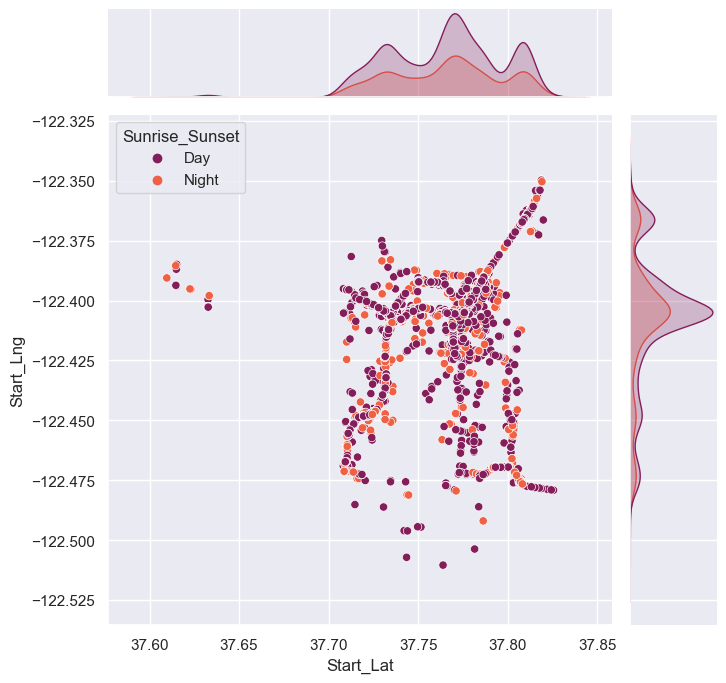

In [16]:
sns.set_theme(style="darkgrid")
g = sns.jointplot(x="Start_Lat", y="Start_Lng", data=df,
                  hue="Sunrise_Sunset",
                  kind="scatter",
                  palette="rocket", height=7)

## III. Data Analysis
### 1. Severity: What makes a bad incident so bad? (Severity Analysis)

The "Severity" column represent the severity of the impact of the traffic incident on the road polyline, ranging from 1 (short delay) to 4 (long delay).There are, however, no given thresholds or indicators on what constitutes a "short" and "long" delay. 

In our data, we observe the vast majority of the logged incidents to be of Severity 2 with a great distance to the runner up, Severity 3. In a geomap distribution of all incidents, we note that the slight majority of the Severity 4 incidents are centered around the beforementiond high density hotspots. Interesting to note, there are no Severity 4 incidents on the Oakland Bay Bridge road segment, i.e. the highest density polyline.

Through an animated heatmap, showing the geomap distribution of the incidents as per their Severity, we observe that Severity 2 clearly makes up for the resulting mapping shapes of previously shown geomaps. Another interesting point to note is the relatively few incidents of Severity 3 and their alignment along the Interstate 280 roadway. While closer examination of damages in each incident is beyond the scope of this project, an interesting observation from this distribution, is that there is rarely long delays caused by traffic incidents along the busy polylines, and even more so anywhere else in San Francisco. This is further discussed in our website deliverable.

In [17]:
# keep only the wanted columns
df_severity = df.drop(columns=['City', 'County', 'State', 'Zipcode',
                               'Country', 'Timezone', 'Airport_Code',
                               'Sunrise_Sunset', 'Civil_Twilight',
                               'Nautical_Twilight', 'Astronomical_Twilight'])

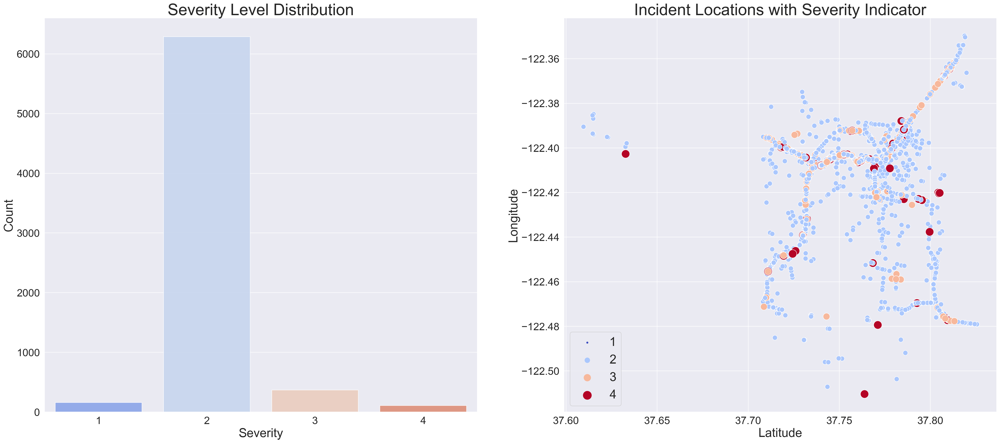

In [18]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(36, 15), dpi=180)
fig.subplots_adjust(hspace=.5)

# plot severity level distribution
sns.set_theme(style="darkgrid")
sns.countplot(data=df_severity, x='Severity',
              alpha=.9, ax=ax1, palette="coolwarm")
ax1.set_title('Severity Level Distribution', fontsize=34)
ax1.set_xlabel('Severity', fontsize=26)
ax1.set_ylabel('Count', fontsize=26)
ax1.tick_params(axis='y', labelsize=22)
ax1.tick_params(axis='x', labelsize=22)

# plot the severity level in scatter plot
sns.scatterplot(x="Start_Lat", y="Start_Lng", data=df_severity,
                hue="Severity", size="Severity", sizes=(10, 300),
                ax=ax2, palette="coolwarm")
ax2.set_title('Incident Locations with Severity Indicator', fontsize=34)
ax2.set_xlabel('Latitude', fontsize=26)
ax2.set_ylabel('Longitude', fontsize=26)
ax2.tick_params(axis='y', labelsize=22)
ax2.tick_params(axis='x', labelsize=22)
ax2.legend(prop={'size': 26}, loc='lower left')

plt.show()

In [19]:
# init the map
map_sf = folium.Map([37.761, -122.465], zoom_start=12, tiles="Stamen Toner")

# list comprehension to make out list of lists
heat_data = [[[row['Start_Lat'], row['Start_Lng']]
              for _, row in df_severity[df_severity['Severity'] == i].iterrows()]
             for i in range(1, 5)]

# plot it on the map
hm = plugins.HeatMapWithTime(heat_data, auto_play=True,
                             max_opacity=0.8,
                             radius=10,
                             index=["Severity level: " + str(x)
                                    for x in range(1, 5)])
hm.add_to(map_sf)

# display the map with a clickable function that returns longitude and latitude
map_sf.add_child(folium.LatLngPopup())
map_sf


The following figures represents the annual growth in recent years of the Severity distribution and evolution. We observe a rise in Severity 2 incidents with time, in addition to 2021 being an especially busy year across all of the Severity categories.

In [20]:
# group the data by year and severity level
# and count the number of incidents in each group
df_severity_cnt_by_year = df_severity.groupby(
    ['Year', 'Severity']).size().reset_index(name='Count')


In [21]:
# pivot the dataframe
pivot_table = pd.pivot_table(df_severity_cnt_by_year, values='Count',
                             index='Severity', columns='Year')

# replace nan with 0
pivot_table.fillna(0, inplace=True)

In [20]:
severity = ['1', '2', '3', '4']
years = ['2016', '2017', '2018', '2019', '2020', '2021']

data = {'severity': severity,
        '2016': pivot_table[2016].tolist(),
        '2017': pivot_table[2017].tolist(),
        '2018': pivot_table[2018].tolist(),
        '2019': pivot_table[2019].tolist(),
        '2020': pivot_table[2020].tolist(),
        '2021': pivot_table[2021].tolist()}

p = figure(x_range=severity, height=350,
           title="Incident Counts by Severity per. year",
           toolbar_location=None, tools="hover",
           tooltips=[("Year", "$name"),
                     ("Severity", "@severity"),
                     ("Count", "@$name")])

p.vbar_stack(years, x='severity', width=0.9,
             source=data, color=bpalettes.BuRd[len(years)],
             legend_label=years)

p.y_range.start = 0
p.x_range.range_padding = 0.1
p.xgrid.grid_line_color = None
p.outline_line_color = None
p.legend.location = "top_right"
p.legend.orientation = "vertical"
p.axis.minor_tick_line_color = None

show(p)

In [25]:
# pivot the dataframe
pivot_table = pd.pivot_table(df_severity_cnt_by_year, 
                             values='Count',
                             index='Year', 
                             columns='Severity')

# replace nan with 0
pivot_table.fillna(0, inplace=True)

severity = ['1', '2', '3', '4']
years = ['2016', '2017', '2018', '2019', '2020', '2021']

data = {'years': years,
        '1': pivot_table[1].tolist(),
        '2': pivot_table[2].tolist(),
        '3': pivot_table[3].tolist(),
        '4': pivot_table[4].tolist()}

p = figure(x_range=years, height=350,
           title="Incident Counts by Year per. severity level",
           toolbar_location=None, tools="hover",
           tooltips=[("Severity", "$name"),
                     ("Count", "@$name")])

p.vbar_stack(severity, x='years', width=0.9,
             source=data, color=bpalettes.BuRd[len(severity)],
             legend_label=severity)

p.y_range.start = 0
p.x_range.range_padding = 0.1
p.xgrid.grid_line_color = None
p.outline_line_color = None
p.legend.location = "top_left"
p.legend.orientation = "vertical"
p.axis.minor_tick_line_color = None

show(p)

#### e) Correlation between severity and surrounding

As the data includes binary columns denoting the pressence of nearby road and traffic elements, such as "STOP" signs, we attempt to investigate correlation of traffic incidents with the pressence of such elements:

In [26]:
# see what features are available
df_severity.columns


Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'District', 'Year', 'Month', 'Hour', 'Weekday',
       'Day_Id'],
      dtype='object')

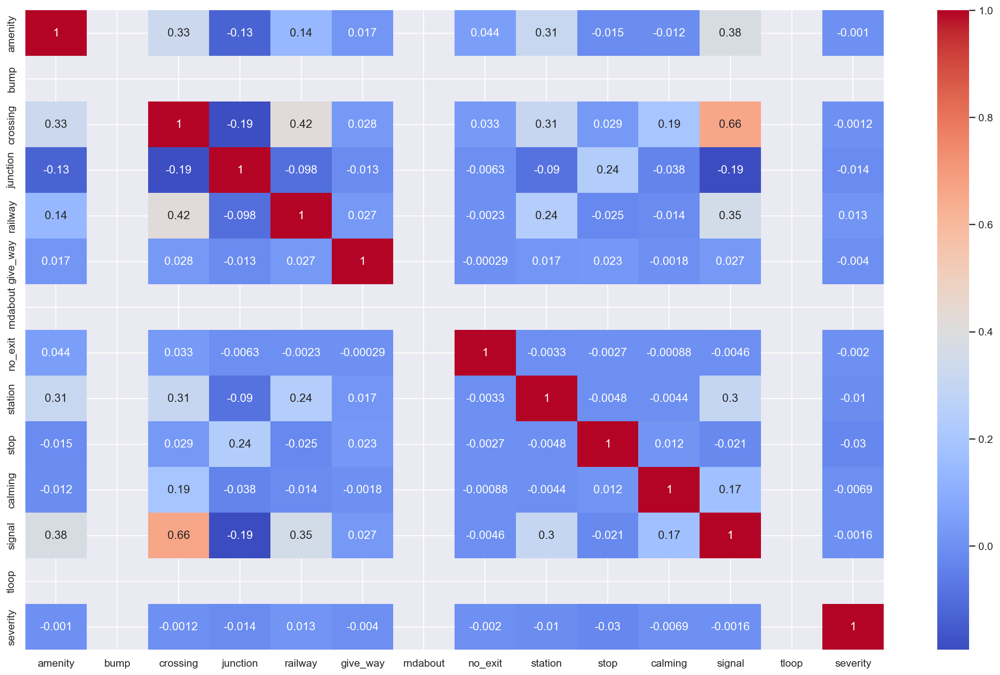

In [27]:
# create binary variables for the features
amenity = np.where(df_severity['Amenity'] == True, 1, 0)
bump = np.where(df_severity['Bump'] == True, 1, 0)
crossing = np.where(df_severity['Crossing'] == True, 1, 0)
junction = np.where(df_severity['Junction'] == True, 1, 0)
railway = np.where(df_severity['Railway'] == True, 1, 0)
give_way = np.where(df_severity['Give_Way'] == True, 1, 0)
rndabout = np.where(df_severity['Roundabout'] == True, 1, 0)
no_exit = np.where(df_severity['No_Exit'] == True, 1, 0)
station = np.where(df_severity['Station'] == True, 1, 0)
stop = np.where(df_severity['Stop'] == True, 1, 0)
calming = np.where(df_severity['Traffic_Calming'] == True, 1, 0)
signal = np.where(df_severity['Traffic_Signal'] == True, 1, 0)
tloop = np.where(df_severity['Turning_Loop'] == True, 1, 0)
severity = np.array(df_severity['Severity'])

# create a new dataframe with the variables
df_surrounding = pd.DataFrame({'amenity': amenity, 'bump': bump,
                               'crossing': crossing, 'junction': junction,
                               'railway': railway, 'give_way': give_way,
                               'rndabout': rndabout, 'no_exit': no_exit,
                               'station': station, 'stop': stop,
                               'calming': calming, 'signal': signal,
                               'tloop': tloop, 'severity': severity})

# calculate the correlation coefficient between them
corr_matrix = df_surrounding.corr()

# plot the correlation matrix
fig = plt.figure(figsize=(20, 12), dpi=150)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


From the correlation coefficients shown above between the severity and the other features, there is not significant correlation. In gerneral, a positive correlation coefficient like the one between railway and severity indicates a positive association between the two variables, while a negative correlation coefficient indicates a negative association. A coefficient close to 0 indicates no correlation, therefore, most of the correlations we observed are rather weak. To visualize this, we plotted the following:

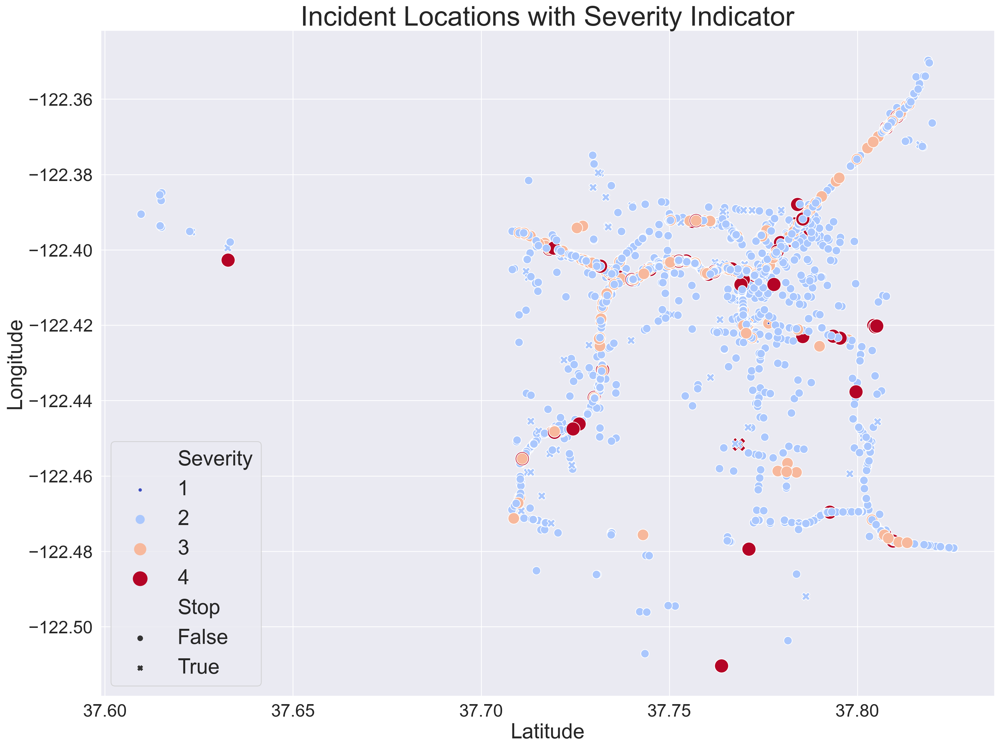

In [28]:
fig, ax = plt.subplots(figsize=(20, 15), dpi=180)

# plot the severity level in scatter plot
sns.scatterplot(x="Start_Lat", y="Start_Lng", data=df_severity,
                hue="Severity", size="Severity",
                style="Stop", sizes=(10, 300), palette="coolwarm")
ax.set_title('Incident Locations with Severity Indicator', fontsize=34)
ax.set_xlabel('Latitude', fontsize=26)
ax.set_ylabel('Longitude', fontsize=26)
ax.tick_params(axis='y', labelsize=22)
ax.tick_params(axis='x', labelsize=22)
ax.legend(prop={'size': 26}, loc='lower left')

plt.show()


In the above-displayed figure, we have examined the correlation among different features in the dataset and plotted the feature "Stop" which indicates if there is a "STOP" traffic sign nearby. Among all low correlation observed, we have found that "Stop" has the "highest" correlation comparing to other features. To highlight this correlation, we have plotted "Stop" with an 'x' on the plot.

Furthermore, wee do not observe red (Severity 4) x's on the plot, which we would have expected if "STOP" was highly correlated with severe incidents. This finding suggests that severe incidents were not necessarily correlated with the presence of stop-signs nearby, even it is already the most correlated one in this surrounding set.

#### f) Correlation between traffic incidents and weather
In this part, we have divided the the features into three set:
- Common weather metrics as in temperature, humidity, pressure etc.
- Weather condition descriptions like 'Mostly Cloudy', 'Scattered Clouds', 'Partly Cloudy', etc.
- Winding conditions including direction and speed. 

With different focuses, we hope that we can find one that are highly correlated to severity level.

In [29]:
# create a new dataframe with the wanted variables
df_weather = df_severity.loc[:, ['Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)',
                             'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)',
                                 'Precipitation(in)', 'Severity']]
df_weather_con = df_severity.loc[:, ['Severity', 'Weather_Condition']]
df_wind = df_severity.loc[:, ['Wind_Direction', 'Wind_Speed(mph)', 'Severity']]

In [30]:
# create binary variables for the features
df_weather_con = pd.get_dummies(df_weather_con)
df_wind = pd.get_dummies(df_wind)

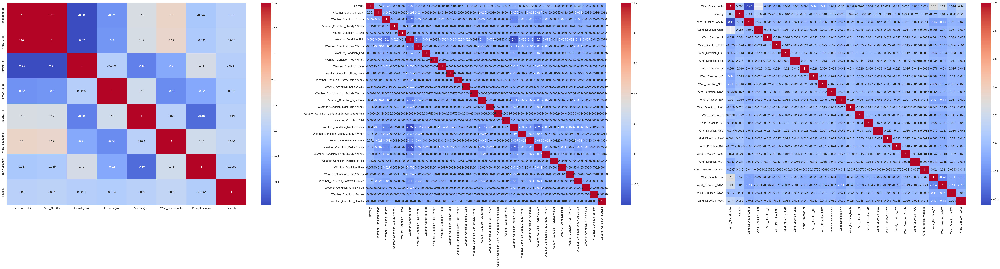

In [31]:
fig = plt.figure(figsize=(75, 15), dpi=180)
fig.subplots_adjust(hspace=.5)

for idx, df in enumerate([df_weather, df_weather_con, df_wind]):
    ax = plt.subplot(1, 3, idx + 1)
    corr_matrix = df.corr()

    # plot the correlation matrix
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', ax=ax)

plt.show()

After conducting an analysis of the data where we compared four sets of correlations, including the one analyzed the surrounding features from previous section, we found that the common weather set had the highest correlation with severity. This finding suggests that weather conditions may play a crucial role in predicting the severity of incidents.


#### g) Decision Tree Model

Based on the result above, we would build a decision tree model to further explore the relationship between weather conditions and incident severity. Decision tree as one of the predictive model is known for its explainability. With its tree structure, it provides a clear and intuitive representation of its decision-making process. By constructing a decision tree model, we could identify the most critical weather factors that contribute to the severity of incidents. This knowledge could ultimately help us develop more effective strategies to mitigate the impact of severe incidents.

In [89]:
# split data into training and testing sets
X = df_weather.fillna(df_weather.mean()).drop('Severity', axis=1)
y = df_weather['Severity']
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    random_state=42)


In [90]:
# define the hyperparameters to search
search = {
    "max_depth": range(3, 10, 2),
    "min_samples_split": range(50, 310, 50),
    "min_samples_leaf": range(10, 90, 10),
}

# set a decision tree classifier with default hyperparameters
clf = DecisionTreeClassifier(random_state=42)
clf.fit(X_train, y_train)

# evaluate performance on the test set
acc = clf.score(X_test, y_test)
print(f"Accuracy with default hyperparameters: {acc:.4f}")

# apply grid search to find the best hyperparameters
grid_search = GridSearchCV(clf, param_grid=search, cv=5)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_
print(f"Best hyperparameters: {best_params}")


Accuracy with default hyperparameters: 0.8650
Best hyperparameters: {'max_depth': 3, 'min_samples_leaf': 10, 'min_samples_split': 50}


In [176]:
# retune the model
clf = DecisionTreeClassifier(max_depth=3,
                             min_samples_leaf=10,
                             min_samples_split=50,
                             random_state=42)
clf.fit(X_train, y_train)

# make predictions on the testing set
y_pred = clf.predict(X_test)

# compute evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred,
                            average='weighted',
                            zero_division=0)
confusion_mat = confusion_matrix(y_test, y_pred)

print('Accuracy:', accuracy)
print('Precision:', precision)


Accuracy: 0.9111913357400722
Precision: 0.8302696503277769


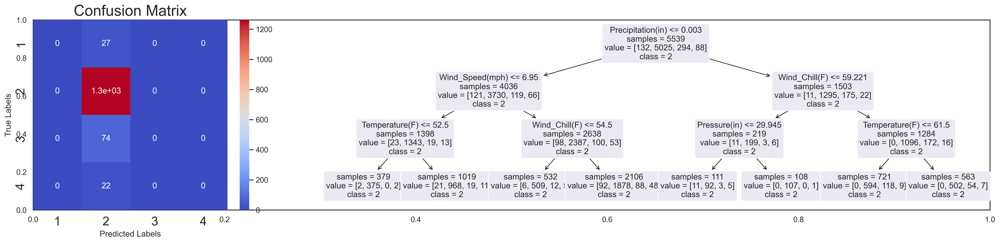

In [188]:
# plot the decision tree together with confusion matrix
sns.set_style("white")
fig, ax = plt.subplots(figsize=(25, 5), dpi=300)
gs = fig.add_gridspec(ncols=2, nrows=1, width_ratios=[0.8, 2.2],
                      wspace=.1, hspace=.2)
fig.subplots_adjust(wspace=.2, hspace=.5)

ax0 = fig.add_subplot(gs[0])
sns.set_style("dark")
sns.heatmap(confusion_mat, annot=True, cmap='coolwarm', ax=ax0)
ax0.set_xticklabels(range(1, 5), size=18)
ax0.set_yticklabels(range(1, 5), ha='right', rotation=90, size=18)
ax0.set_title('Confusion Matrix', size=22)
ax0.set_xlabel('Predicted Labels')
ax0.set_ylabel('True Labels')

ax1 = fig.add_subplot(gs[1])
ax1.set_title('Decision Tree Model for Severity Prediction')
plot_tree(clf, rounded=True,
          fontsize=12,
          impurity=False,
          feature_names=X.columns,
          class_names=['1', '2', '3', '4'],
          filled=False, ax=ax1)
ax1.set_facecolor("none")
plt.show()

As predictive model that built to assess the severity of traffic incidents based on common weather metrics, its performance numberaically good given accuracy is at $91.12\%$ and precision at $83.02\%$. When accuracy measures the overall correctness of a model's predictions, precision measures the proportion of correct positive predictions out of all positive predictions as what we can observe in the confusion matrix, where both the true label and the predicted label were the same.

As aforementioned, decision tree can help to identify the most important features for predicting traffic incident severity and the thresholds at which these features become significant. In the tree plot, the root node splits on the **precipitation** feature, suggesting that it is an important feature for the model. The subsequent nodes in the tree split on other features, such as wind speed and temperature, indicating that these features are also important, but when going futher down on the tree, those features become less important while making predictions.

It is important to note that the distribution of severity in the training set is imbalanced, as indicated by previous plots. Specifically, the majority of samples belong to level 2, while the other levels are underrepresented. This imbalanced distribution could have significant impact on the performance of the decision tree model. Hence, the model is currrently only making predictions to level 2, which unfortunately makes it unpractical, and can be improved by feeding balanced data, or other methodes to eliminate this bias.

### 2. Traffic related crime
#### a) general investigation on crimes

In this section, we would love to know if there is a relationship between the severity of traffic accidents and the prevalence of traffic-related crimes in San Francisco. We started by gathered the crime report data, then see what would be the relevant crime type, and lastly we checked if they are overlapped in a way.

In [33]:
# load the .csv file that located under the same path as this notebook
df_police_1 = pd.read_csv('Police_Department_Incident_Reports__Historical_2003_to_May_2018.csv',
                          engine='python')
df_police_1.name = 'Incident Reports From 2003 to 2018'

df_police_2 = pd.read_csv('Police_Department_Incident_Reports__2018_to_Present.csv',
                          engine='python')
df_police_2.name = 'Incident Reports From 2018 to Present'

# restrict to year from 2016 to 2021,
# which were included in the traffic report
df_police_1['Date'] = df_police_1['Date'].astype('datetime64')
df_police_1['Year'] = df_police_1['Date'].dt.year
df_police_1 = df_police_1[df_police_1['Year'].isin([2016, 2017])]

# reconstruct the df2
df_police_2.rename(columns={"Incident Date": "Date",
                            "Incident Year": "Year",
                            "Incident Category": "Category",
                            "Longitude": "X", "Latitude": "Y"},
                   inplace=True)
df_police_2 = df_police_2[(df_police_2['Year'] <= 2021)]

In [129]:
# see the possible related crime types
print(df_police_1['Category'].unique())
print(df_police_2['Category'].unique())

['ASSAULT' 'VEHICLE THEFT' 'LARCENY/THEFT' 'VANDALISM' 'FRAUD'
 'NON-CRIMINAL' 'ROBBERY' 'DRUG/NARCOTIC' 'OTHER OFFENSES' 'WEAPON LAWS'
 'TRESPASS' 'MISSING PERSON' 'WARRANTS' 'SECONDARY CODES'
 'FORGERY/COUNTERFEITING' 'EMBEZZLEMENT' 'SUSPICIOUS OCC' 'BURGLARY'
 'RECOVERED VEHICLE' 'DRUNKENNESS' 'DRIVING UNDER THE INFLUENCE'
 'SEX OFFENSES, FORCIBLE' 'PROSTITUTION' 'STOLEN PROPERTY'
 'DISORDERLY CONDUCT' 'LIQUOR LAWS' 'ARSON' 'KIDNAPPING' 'SUICIDE'
 'EXTORTION' 'BRIBERY' 'LOITERING' 'GAMBLING' 'TREA' 'BAD CHECKS'
 'SEX OFFENSES, NON FORCIBLE' 'PORNOGRAPHY/OBSCENE MAT']
['Lost Property' 'Assault' 'Larceny Theft' 'Recovered Vehicle' 'Fraud'
 'Non-Criminal' 'Other Offenses' 'Warrant' 'Malicious Mischief' 'Robbery'
 'Case Closure' 'Other Miscellaneous' 'Stolen Property'
 'Offences Against The Family And Children' 'Other' 'Motor Vehicle Theft'
 'Traffic Collision' 'Suspicious Occ' 'Missing Person'
 'Disorderly Conduct' 'Weapons Carrying Etc' 'Rape' 'Drug Offense'
 'Burglary' 'Fire Report' 

In [34]:
# pick the types that might be relevant
focuscrimes = ['DRIVING UNDER THE INFLUENCE']
focuscrimes_new = ['Traffic Collision', 'Traffic Violation Arrest']

In [35]:
# filter out the crimes that we are interested in
df_police_1 = df_police_1.loc[:, ["Category", "Year", "X", "Y"]]
df_police_1 = df_police_1[df_police_1['Category'].isin(focuscrimes)]
df_police_2 = df_police_2.loc[:, ["Category", "Year", "X", "Y"]]
df_police_2 = df_police_2[df_police_2['Category'].isin(focuscrimes_new)]
df_crime = pd.concat([df_police_1, df_police_2])

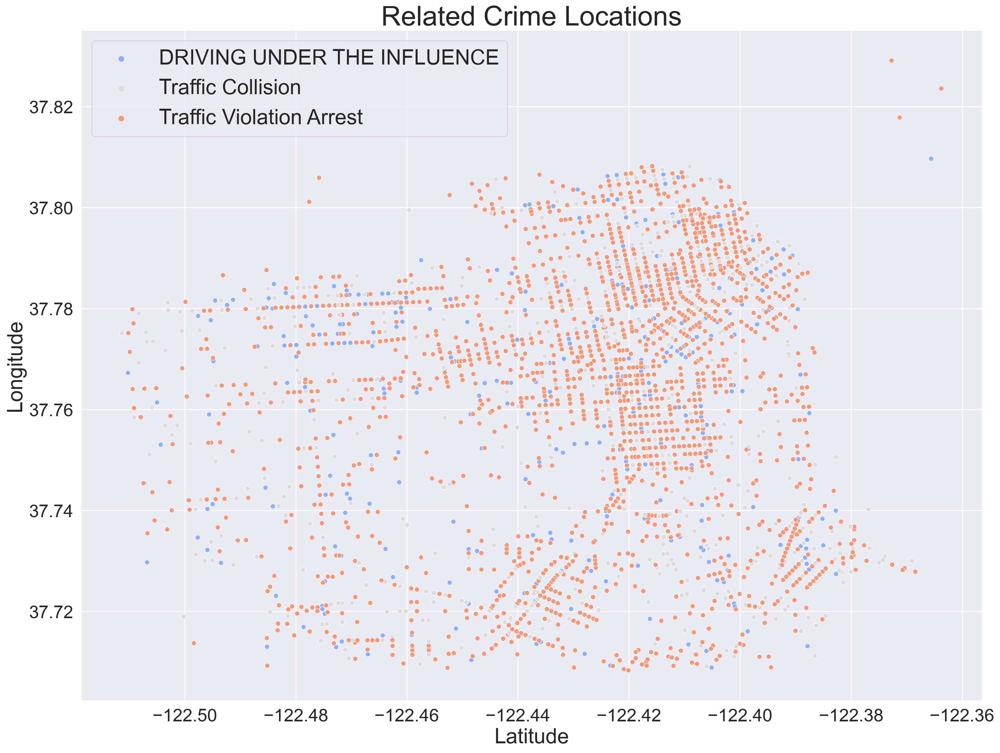

In [36]:
fig, ax = plt.subplots(figsize=(20, 15), dpi=180)

# plot the crimes in scatter plot
sns.scatterplot(x="X", y="Y", data=df_crime,
                hue="Category", palette="coolwarm")
ax.set_title('Related Crime Locations', fontsize=34)
ax.set_xlabel('Latitude', fontsize=26)
ax.set_ylabel('Longitude', fontsize=26)
ax.tick_params(axis='y', labelsize=22)
ax.tick_params(axis='x', labelsize=22)
ax.legend(prop={'size': 26}, loc='upper left')

plt.show()

In [37]:
x0 = df_crime[df_crime['Category'] == 'DRIVING UNDER THE INFLUENCE'].X
y0 = df_crime[df_crime['Category'] == 'DRIVING UNDER THE INFLUENCE'].Y
x1 = df_crime[df_crime['Category'] == 'Traffic Collision'].X
y1 = df_crime[df_crime['Category'] == 'Traffic Collision'].Y
x2 = df_crime[df_crime['Category'] == 'Traffic Violation Arrest'].X
y2 = df_crime[df_crime['Category'] == 'Traffic Violation Arrest'].Y

# create the figure
fig = go.Figure()

# Add traces
fig.add_trace(
    go.Scatter(
        x=x0,
        y=y0,
        opacity=.5,
        mode="markers",
        marker=dict(color="DarkOrange")
    ))

fig.add_trace(
    go.Scatter(
        x=x1,
        y=y1,
        opacity=.5,
        mode="markers",
        marker=dict(color="Crimson")
    ))

fig.add_trace(
    go.Scatter(
        x=x2,
        y=y2,
        opacity=.5,
        mode="markers",
        marker=dict(color="RebeccaPurple")
    ))

# Add buttons that add shapes
cluster0 = [dict(type="circle",
                 xref="x", yref="y",
                 x0=min(x0), y0=min(y0),
                 x1=max(x0), y1=max(y0),
                 line=dict(color="DarkOrange"))]
cluster1 = [dict(type="circle",
                 xref="x", yref="y",
                 x0=min(x1), y0=min(y1),
                 x1=max(x1), y1=max(y1),
                 line=dict(color="Crimson"))]
cluster2 = [dict(type="circle",
                 xref="x", yref="y",
                 x0=min(x2), y0=min(y2),
                 x1=max(x2), y1=max(y2),
                 line=dict(color="RebeccaPurple"))]

fig.update_layout(
    width=600,
    height=400,
    margin=dict(l=5, t=50, b=5),
    updatemenus=[
        dict(
            type="buttons",
            buttons=[
                dict(label="None",
                     method="update",
                     args=[{"visible": [True, True, True, True]},
                           {"shapes": []}]),
                dict(label="Driving under the influence",
                     method="update",
                     args=[{"visible": [True, False, False, False]},
                           {"shapes": cluster0}]),
                dict(label="Traffic collision",
                     method="update",
                     args=[{"visible": [False, True, False, False]},
                           {"shapes": cluster1}]),
                dict(label="Traffic violation arrest",
                     method="update",
                     args=[{"visible": [False, False, True, False]},
                           {"shapes": cluster2}]),
                dict(label="All",
                     method="update",
                     args=[{"visible": [True, True, True, True]},
                           {"shapes": cluster0 + cluster1 + cluster2}])
            ],
            # adjust the position of the buttons
            x=1.05,
            y=0.95,
            xanchor="left",
            yanchor="top",
            pad=dict(r=10, t=10)
        )])

# update remaining layout properties
fig.update_layout(
    title_text="Traffic Related Crime Locations",
    showlegend=False)

fig.show()

The generated plot provides valuable insights into the relationship between traffic accidents and various crimes. By interacting with the plot and clicking on different crime categories, we gain a clear understanding of the number of accidents associated with each category, namely driving under the influence, traffic collision, and traffic violation arrest. Moreover, the plot reveals the specific locations in the city, identified by latitude and longitude, where these incidents occur.

By exploring the plot, we can observe the correlation between certain criminal activities and traffic accidents. It becomes evident that a portion of traffic accidents is linked to criminal behavior, particularly driving under the influence, traffic collisions, and incidents resulting in traffic violation arrests. The ability to interact with the plot allows us to delve deeper into each category, gaining a comprehensive overview of their respective spatial distributions.

By pinpointing the locations of these incidents, politicians or any other stakeholder can identify areas of concern and implement targeted measures to address crime-related traffic accidents effectively. Furthermore, the plot provides a valuable tool for law enforcement agencies to identify areas with high crime rates and traffic accidents, allowing them to allocate resources accordingly.

#### b) Further investigation on Driving Under Influence (DUI)

Driving under the influence(DUI) a serious criminal offense that refers to the act of operating a motor vehicle while impaired by alcohol or drugs. As a very common reason for causing traffic incident, this practice is illegal in many countries. The risks of DUI cannot be overstated as **impaired drivers are more likely to cause accidents** that result in serious injury or death to themselves and others on the road. This makes it crucial to analyze any correlations between DUI arrests and the recorded traffic incidents.

The data we have for "driving under influence" were only available during 2016-2017, we would therefore accordingly cut the traffic incident report down.

In [54]:
# sort out the wanted columns
df_dui = df_police_1[df_police_1['Category'] == 'DRIVING UNDER THE INFLUENCE']
df_severity_dui = df_severity[df_severity['Year'].isin([2016, 2017])]
df_severity_dui = df_severity_dui.loc[:, ['Severity', 'Start_Lat',
                                      'Start_Lng', 'Year']]
df_dui.rename(columns={"Category": "Reported", "Y": "Start_Lat",
                       "X": "Start_Lng"}, inplace=True)

# redefine the Severity and Reported column
df_dui['Severity'] = 1
df_dui.loc[:, 'Reported'] = 1
df_severity_dui['Reported'] = 0

# combining the two df
df_dui = pd.concat([df_severity_dui, df_dui])

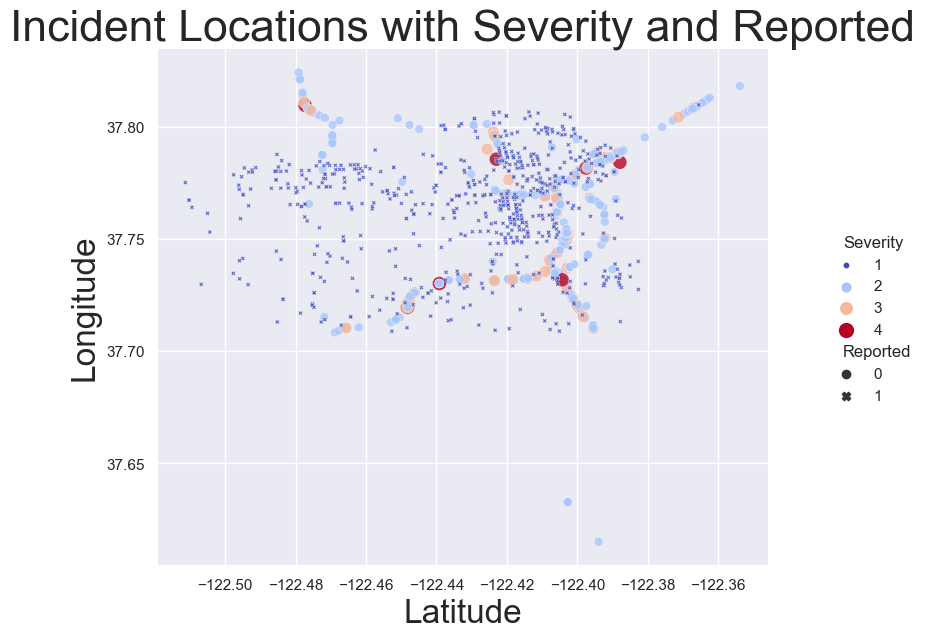

In [56]:
# plot the incidents in scatter plot
g = sns.relplot(
    data=df_dui,
    x="Start_Lng", y="Start_Lat",
    hue="Severity", size="Severity",
    style="Reported", alpha=.8,
    palette="coolwarm", sizes=(10, 100),
    height=6, aspect=1.2
)
g.ax.xaxis.grid(True, "minor", linewidth=.25)
g.ax.yaxis.grid(True, "minor", linewidth=.25)
g.ax.set_title('Incident Locations with Severity and Reported',
               fontsize=28)
g.ax.set_xlabel('Latitude', fontsize=22)
g.ax.set_ylabel('Longitude', fontsize=22)
g.despine(left=True, bottom=True)
plt.show()

All the reported incidents from San Francisco police department are defined as severity level 1 (navy blue cross) for better visualization in the plot, for there were no incident with level 1 severity in the original incident report.

In [80]:
# set the parameters
severity = range(1, 5)
colors = ["lightseagreen", "royalblue", "orange", "crimson"]
scale = 5

fig = go.Figure()

for i in range(len(severity)):
    lim = severity[i]
    df_sub = df_dui[df_dui['Severity'] == lim]
    fig.add_trace(go.Scattergeo(
        locationmode="geojson-id",
        lon=df_sub['Start_Lng'],
        lat=df_sub['Start_Lat'],
        name=lim,
        geojson=sf,
        marker=dict(
            size=df_sub['Severity']*scale,
            color=colors[i],
            line_color='rgb(40,40,40)',
            line_width=0.5,
            sizemode='area'
        )
    ))

fig.update_layout(
    title_text='Incident Locations with Severity and Reported',
    showlegend=True,
    geo=dict(
        scope='north america',
        center={'lat': 37.7749, 'lon': -122.4194},
        landcolor='rgb(217, 217, 217)',
        projection_type='albers usa',
        fitbounds="geojson"
    )
)

fig.update_layout(
    width=600,
    height=400,
    margin=dict(l=5, t=50, b=5, r=50)
)

fig.show()

The interactive map provides insights with "driving under the influence" which is indicated as level 1 severity. While 2, 3 and 4 represent the original data points.

## IV. Genre
Our genre of choice for this project is a **Magazine style** article as we are believe this is the most appropiate genre for our story. We interpet the Magazine style as the most fitting due to its weight on storytelling and visualizations, often in combination with external sources. 

Without having to pinpoint exactly what visual narrative tools we used in our project, we wanted to put emphasis on making every next plot exciting for the reader; that the next plot would not be of similar type or storytelling as the previous but that every plot and its correspondering analysis would be important to understand before being able to move on to the next. We also wanted to emphasize on the sheer prevelance of Severity 2 incidents in our data by color-coding the severities in geographically-induced plots. As we are likely all familiar with road accidents, however small they may be, big crashes are (fortunately) indeed rare. We also put emphasis on displaying a San Francisco-shaped map in as many plots as possible for geographic overview and consistency.

As for our narrative structure, we emphasized on connecting our exploratory section to facts and news, e.g. referring to national tendencies, and highlight SF government's Vision Zero policy for the fall in severe incidents. Our decision to split the data analysis in "Analysis" and "Maps" was not only to distinguih the mentality of the viewers when entering different graphical sections, but also to keep pages seemingly short and concise. We believe that merging these sections together would have our readers slowly fall off during reading, and ultimately not pay sufficient attention to more advanced parts such as the correlation segment. We purposely omitted the "end" in "start, middle, end" structure because we wanted to leave the end open for further investigation and analysis - that our work was just the tip of the iceberg. 

In summary, following Visual Narrative tools have conciously been used: establishing overview, matching objects,  *subject-to-subject*, annotations (to enrich narrative).
And Narrative Structure tools conciously used: start and middle without end/resolution, hero's journey including some side quests, and split-screen sequences.

## V. Visualizations
The visualization we have chosen have been selected *on the go*, meaning they have been picked as we've been exploring the data and driving the narrative on the run. We have purposely gone with this approach because our target audience are our fellow classmates of whom we presume the average student by now share same expertise and strengths as us. We wanted to first and foremost include course material as the primary visualization selection criteria, but we've also wanted to highlight our coding and result analysis skills. As the thematics of our data and project idea stronghly emphasizes on geodata, we've purposely aimed at using latitude and longitude columns wherever possible, also to shape the main roads of SF and have the same polylines showing across as many visualizations as possible to maintain consistency and to not force readers to enter new visualizations with reset minds. Central thematic of our data is also date and time columns which we've tried to highlight using time-series elements wherever appropiate, to display annual growth of traffic in SF. This is particularly relevant when considering SF's "Vision Zero" policy is subject for review next year.

## VI. Discussion
As a deliverable, we believe our project has conluded as excellent and thorough. We emphasized on including thorough exploratory analysis as we've been taught in class from the very beginning, which we've also used to explain the data to our readers. We believe our considerations and analyses have been well picked and transitioned inbetween in good manners. As previously mentioned, we have left the end-part relatively open (i.e. without a final conclusion) because we believe our analyses prompts for further investigations and encourage the readers to think of other correlations or research angles on their own. In hindsight, there will always be several points of potential improvements. A big part of this is caused by our drastic change of project idea late into the schedule. We believed our original project idea was rather bland and did not yield enough room for "analysis" after the feedback by Sune and discussing other groups' project ideas. We are aware of certain points in which we could have improved our story and data analysis, and we're likewise confident in our ability to have improved the deliverable if given more time.
Even though some of the group members had a background in software development, the technology of jekyll was very different to prior expierence. If time allowed it, we would have made some of the visualizations a bit more readable in the section of machine learning. 
As for the decision model, it was built for predicting the severity level given the weather conditions, yet the imbalanced data made a biased model. To improve its performance, we could have resample the dataset to eliminate the embedded biased. Alternatively, three non-discrimination criteria can be employed while training the model, namely independence, separation and sufficiency. By conducting one of the method, we can ensure that the resulting model is unbiased and provides accurate predictions for all severity levels.

## Contributions

We deem that all members in the group share the same contribution to this project.

| Section          | Mustafa | Ibrahim | Xueying |
| -----------------|:-------:|:-------:|:-------:|
| Data Analysis    | 40%     | 30%     | 30%     |
| Machine Learning | 20%     | 20%     | 60%     |
| Visualizations   | 25%     | 25%     | 50%     |
| Discussion       | 50%     | 35%     | 15%     |
| Webpage          | 20%     | 60%     | 20%     |

